In [1]:
import sys
!{sys.executable} -m pip install torchscan torchsummary

In [3]:
import argparse
import os
import random
import math

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as vdatasets
import torchvision.transforms as T
import torchvision.utils as vutils

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns
import pandas as pd

from IPython.display import HTML

from torchscan import summary
# from torchsummary import summary

import tqdm
from tqdm.notebook import tqdm as tqdm_nb

import warnings
warnings.filterwarnings("ignore")

# os.environ['TORCH_HOME'] = '~/torch_home'
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

manualSeed = 999
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


# Source code

based on [PyTorch DCGAN Tutorial](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)

In [16]:
# Number of workers for dataloader
workers = 16

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 10

# Nubmer of loop to train ciritic
n_critics = 5

# Learning rate for optimizers
lr = 0.0001

# Weight Clipping Limit
weight_cliping_limit = 0.01

# Beta1 hyperparam for Adam optimizers
beta1 = 0.0
beta2 = 0.9

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

# CelebA Dataset

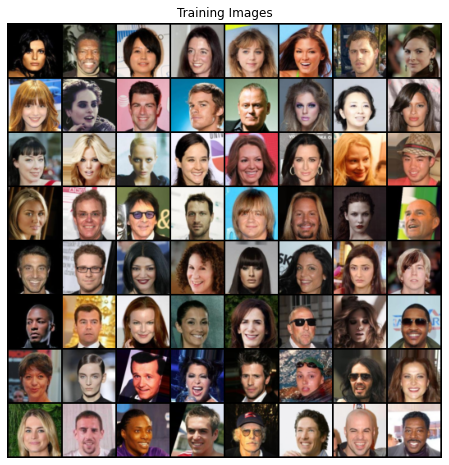

In [17]:
dataset = vdatasets.ImageFolder(root='./CelebA/img_align_celeba/',
                                transform=T.Compose([
                                    T.Resize(image_size),
                                    T.CenterCrop(image_size),
                                    T.ToTensor(),
                                    T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                ]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

device = torch.device('cuda' if (torch.cuda.is_available() and ngpu > 0) else 'cpu')

one_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title('Training Images')
plt.imshow(np.transpose(vutils.make_grid(one_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

# Utils

In [18]:
# custom weights initialization called on netG and netD
def weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [19]:
class SaveCheckpoint:
    def __init__(self, path = None):
        self.loss = np.inf
        self.path = path or os.path.join('.')
    
    def update(self, model, loss):
        if self.loss > loss:
            self.loss = loss
            self.save(model)

    def save(self, model, name):
        if isinstance(model, nn.Module):
            model = [model]
            name = [name]
        for m, n in zip(model, name):
            torch.save(m.state_dict(), '{}/{}.pth'.format(self.path, n))

# Define Models

In [20]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, z=nz):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(z, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [21]:
# Create the generator
netG = Generator().to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
summary(netG, (nz, 1, 1))

______________________________________________________________
Layer        Type               Output Shape         Param #  
generator    Generator          (-1, 3, 64, 64)      0        
├─main       Sequential         (-1, 3, 64, 64)      0        
|    └─0     ConvTranspose2d    (-1, 512, 4, 4)      819,200  
|    └─1     BatchNorm2d        (-1, 512, 4, 4)      2,049    
|    └─2     ReLU               (-1, 512, 4, 4)      0        
|    └─3     ConvTranspose2d    (-1, 256, 8, 8)      2,097,152
|    └─4     BatchNorm2d        (-1, 256, 8, 8)      1,025    
|    └─5     ReLU               (-1, 256, 8, 8)      0        
|    └─6     ConvTranspose2d    (-1, 128, 16, 16)    524,288  
|    └─7     BatchNorm2d        (-1, 128, 16, 16)    513      
|    └─8     ReLU               (-1, 128, 16, 16)    0        
|    └─9     ConvTranspose2d    (-1, 64, 32, 32)     131,072  
|    └─10    BatchNorm2d        (-1, 64, 32, 32)     257      
|    └─11    ReLU               (-1, 64, 32, 32)     0 

In [22]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            # nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [23]:
# Create the Discriminator
netD = Discriminator().to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
summary(netD, (3, 64, 64))

________________________________________________________________
Layer            Type             Output Shape         Param #  
discriminator    Discriminator    (-1, 1, 1, 1)        0        
├─main           Sequential       (-1, 1, 1, 1)        0        
|    └─0         Conv2d           (-1, 64, 32, 32)     3,072    
|    └─1         LeakyReLU        (-1, 64, 32, 32)     0        
|    └─2         Conv2d           (-1, 128, 16, 16)    131,072  
|    └─3         BatchNorm2d      (-1, 128, 16, 16)    513      
|    └─4         LeakyReLU        (-1, 128, 16, 16)    0        
|    └─5         Conv2d           (-1, 256, 8, 8)      524,288  
|    └─6         BatchNorm2d      (-1, 256, 8, 8)      1,025    
|    └─7         LeakyReLU        (-1, 256, 8, 8)      0        
|    └─8         Conv2d           (-1, 512, 4, 4)      2,097,152
|    └─9         BatchNorm2d      (-1, 512, 4, 4)      2,049    
|    └─10        LeakyReLU        (-1, 512, 4, 4)      0        
|    └─11        Conv2d  

In [24]:
# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, beta2))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, beta2))

# Gradient Penalty

In [25]:
def gradient_penalty(D, real_samples, fake_samples):
    """Calculates the gradient penalty loss for WGAN GP"""
    # Random weight term for interpolation between real and fake samples
    batch_size = real_samples.size(0)
    alpha = torch.randn(batch_size, 1, 1, 1, device=device).float()
    # Get random interpolation between real and fake samples
    interpolates = (alpha * real_samples + ((1 - alpha) * fake_samples)).requires_grad_(True)
    d_interpolates = D(interpolates)
    real_label = torch.full((batch_size, 1, 1, 1), 1.0, dtype=torch.float, device=device)
    fake = torch.autograd.Variable(real_label, requires_grad=False)
    # Get gradient w.r.t. interpolates
    gradients = torch.autograd.grad(
        outputs=d_interpolates,
        inputs=interpolates,
        grad_outputs=fake,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]
    gradients = gradients.view(gradients.size(0), -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return gradient_penalty

In [26]:
lambda_gp = 10

# Train Loop

In [27]:
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []

total_steps = num_epochs * len(dataloader)
fig_save_interval = total_steps // 30   # animation can contain max 36 images

pbar = tqdm_nb()
piter = 0

checkpoint = SaveCheckpoint()

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    epoch_steps = len(dataloader)
    pbar.reset(total=epoch_steps)
    for i, data in enumerate(dataloader, 0):
        pbar.update()
        piter += 1
        ################################################################
        # (1) Update D network
        ################################################################
        netD.zero_grad()
        
        real_img = data[0].to(device)
        b_size = real_img.size(0)
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake_img = netG(noise)
        
        real_validity = netD(real_img)
        fake_validity = netD(fake_img)
        
        realD = -torch.mean(real_validity)
        
        # calculate gradient penalty
        gp = gradient_penalty(netD, real_img, fake_img)
        gp.backward()
        
        # adversarial loss
        errD = realD + torch.mean(fake_validity) + lambda_gp * gp
        optimizerD.step()
        
        # Train Generator for every 5 steps
        if i % n_critics == 0:
            ################################################################
            # (2) Update G network
            ################################################################
            netG.zero_grad()

            gen_img = netG(noise)
            errG = -torch.mean(netD(gen_img))
            errG.backward()
            optimizerG.step()

            # Output training stats
            desc = '[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f' \
                    % (epoch+1, num_epochs, i, epoch_steps, errD.item(), errG.item())
            pbar.set_description(desc)

            # Save Losses for plotting later
            G_losses.append(errG.item())
            D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (piter - 1) % fig_save_interval == 0:
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append((epoch+1, i, vutils.make_grid(fake, padding=2, normalize=True)))
            print(desc)

pbar.refresh()

checkpoint.save([netG, netD], ['CelebA_netG', 'CelebA_netD'])

0it [00:00, ?it/s]

Starting Training Loop...
[1/10][0/1583] Loss_D: 37.3310 Loss_G: 0.3843
[1/10][525/1583] Loss_D: -383.5172 Loss_G: 191.3233
[1/10][1050/1583] Loss_D: -413.1203 Loss_G: 78.0146
[1/10][1580/1583] Loss_D: -1038.6655 Loss_G: 490.0262
[2/10][525/1583] Loss_D: -1356.3805 Loss_G: 677.8287
[2/10][1050/1583] Loss_D: -1653.0117 Loss_G: 844.0109
[2/10][1575/1583] Loss_D: -2166.0942 Loss_G: 1092.7649
[3/10][520/1583] Loss_D: -2711.1118 Loss_G: 1365.0876
[3/10][1050/1583] Loss_D: -3157.7939 Loss_G: 1591.0848
[3/10][1575/1583] Loss_D: -3703.4080 Loss_G: 1860.3865
[4/10][520/1583] Loss_D: -4276.3066 Loss_G: 2151.4321
[4/10][1045/1583] Loss_D: -4735.5044 Loss_G: 2394.6467
[4/10][1575/1583] Loss_D: -5391.1333 Loss_G: 2713.0469
[5/10][515/1583] Loss_D: -2166.8945 Loss_G: 2462.2158
[5/10][1045/1583] Loss_D: -6374.1548 Loss_G: 3231.4058
[5/10][1570/1583] Loss_D: -6711.4058 Loss_G: 3430.1470
[6/10][515/1583] Loss_D: -7198.3281 Loss_G: 3780.3242
[6/10][1040/1583] Loss_D: -8036.6572 Loss_G: 4072.8936
[6/10][

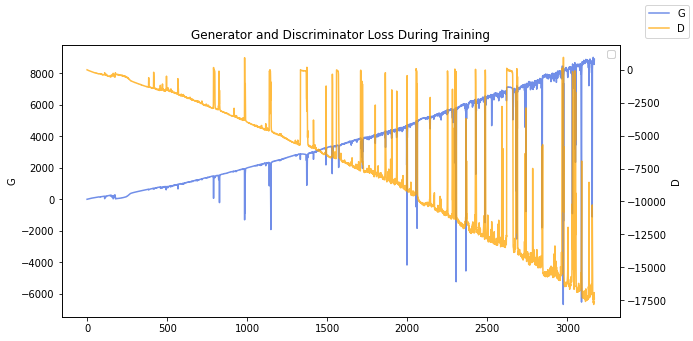

In [28]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
df = pd.DataFrame({'G': G_losses[1:], 'D': D_losses[1:]})
ax1 = sns.lineplot(data=df, x=df.index, y='G', label='G', color='royalblue', alpha=.75)
ax2 = ax1.twinx()
sns.lineplot(data=df, x=df.index, y='D', label='D', color='orange', alpha=.75, ax=ax2)
for ax in [ax1, ax2]:
#     ax.set_ylim(bottom=0.)
    ax.legend([])
ax1.figure.legend()
plt.show()

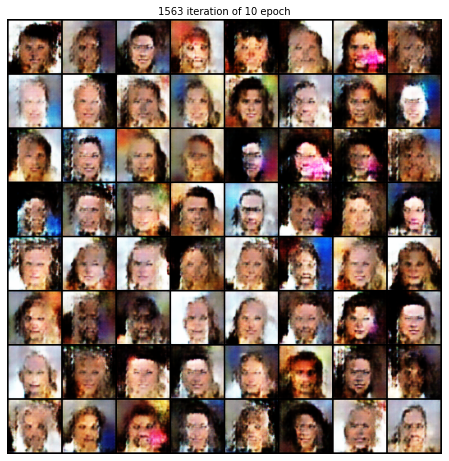

In [29]:
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111)
plt.axis('off')
imgs = [[
    plt.imshow(np.transpose(img, (1,2,0)), animated=True),
    plt.text(0.5, 1.01, f'{step} iteration of {epoch} epoch', horizontalalignment='center', transform=ax.transAxes),
] for epoch, step, img in img_list]

ani = animation.ArtistAnimation(fig, imgs, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

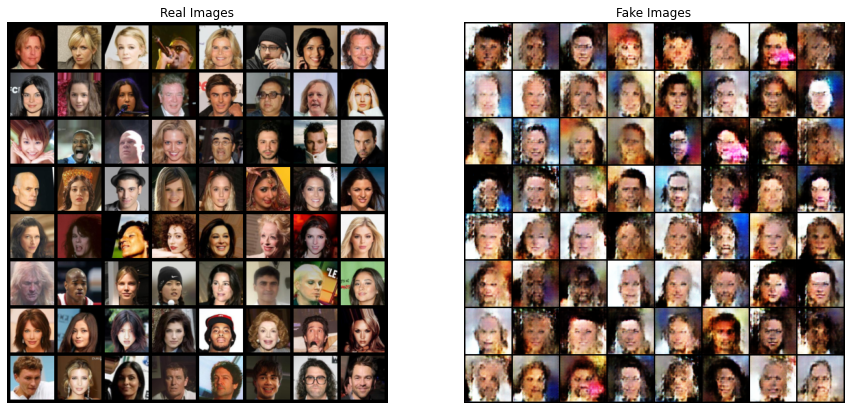

In [30]:
real_batch = next(iter(dataloader))

plt.figure(figsize=(15, 15))

plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1][-1],(1,2,0)))
plt.show()

# Interpolation

In [31]:
def interpolate_points(p1, p2, n_steps=10):
    ratios = np.linspace(0, 1, num=n_steps)
    vs = []
    for ratio in ratios:
        v = (1.0 - ratio) * p1 + ratio * p2
        vs.append(v)
    return torch.stack(vs)

In [32]:
n1 = torch.randn(5, nz, 1, 1, device=device)
n2 = torch.randn(5, nz, 1, 1, device=device)
fake = []
for i in range(5):
    point = interpolate_points(n1[i], n2[i]).to(device)
    fake.append(netG(point))
fake = torch.vstack(fake).cpu()

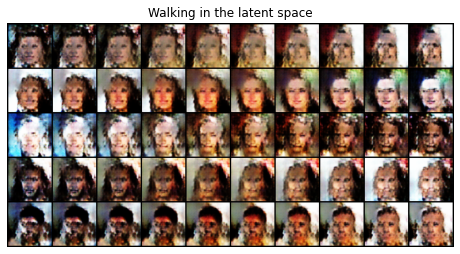

In [33]:
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title('Walking in the latent space')
plt.imshow(np.transpose(vutils.make_grid(fake, nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
plt.show()

Can not expected features before seeing result from noise, so checking average is meaningless here

In [34]:
# # average list of latent space vectors
# def average_points(points, ix):
#     return np.mean(points[ix], axis=0)

In [35]:
# f_smiling = [22, 24, 29, 30, 59]
# f_neutral = [7, 9, 13, 18, 60]
# f_short = [8, 26, 37, 41, 45]
# f_long = [20, 25, 28, 35, 48]

In [36]:
# noise_cpu = fixed_noise.detach().cpu().numpy()
# avg_smiling = average_points(noise_cpu, f_smiling)
# avg_neutral = average_points(noise_cpu, f_neutral)
# avg_short = average_points(noise_cpu, f_short)
# avg_long = average_points(noise_cpu, f_long)
# avg_imgs = torch.from_numpy(np.stack([avg_smiling, avg_neutral, avg_short, avg_long])).to(device)

In [37]:
# plt.figure(figsize=(8, 8))
# plt.axis('off')
# plt.title('Average points (Smile / Neutral / Short / Long)')
# plt.imshow(np.transpose(vutils.make_grid(netG(avg_imgs), nrow=6, padding=2, normalize=True).cpu(), (1,2,0)))
# plt.show()

In [38]:
# short_to_long = interpolate_points(torch.from_numpy(avg_short), torch.from_numpy(avg_long)).to(device)

# plt.figure(figsize=(12, 2))
# plt.axis('off')
# plt.title('Short to long hair')
# plt.imshow(np.transpose(vutils.make_grid(netG(short_to_long), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
# plt.show()

# Vector Arithmetic

In [39]:
# smiling_short = (fixed_noise[f_smiling] - fixed_noise[f_neutral] + fixed_noise[f_short]).to(device)

# plt.figure(figsize=(12, 2))
# plt.axis('off')
# plt.title('Smiling - Neutral + Short hair')
# plt.imshow(np.transpose(vutils.make_grid(netG(smiling_short), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
# plt.show()

In [40]:
# neutral_short = (fixed_noise[f_neutral] - fixed_noise[f_smiling] + fixed_noise[f_short]).to(device)

# plt.figure(figsize=(12, 2))
# plt.axis('off')
# plt.title('Neutral - Smiling + Short hair')
# plt.imshow(np.transpose(vutils.make_grid(netG(neutral_short), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
# plt.show()

In [41]:
# long_smiling = (fixed_noise[f_long] - fixed_noise[f_short] + fixed_noise[f_smiling]).to(device)

# plt.figure(figsize=(12, 2))
# plt.axis('off')
# plt.title('Long hair - Short hair + Smiling')
# plt.imshow(np.transpose(vutils.make_grid(netG(long_smiling), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
# plt.show()

In [42]:
# short_smiling = (fixed_noise[f_short] - fixed_noise[f_long] + fixed_noise[f_smiling]).to(device)

# plt.figure(figsize=(12, 2))
# plt.axis('off')
# plt.title('Short hair - Long hair + Smiling')
# plt.imshow(np.transpose(vutils.make_grid(netG(short_smiling), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
# plt.show()

# LSUN Dataset

Overwrite hyper parameters

In [43]:
batch_size = 64

num_epochs = 10

# lr = 0.0002

weight_cliping_limit = 0.01

n_critics = 5

Remove all used variables for previous model and to let them free

In [44]:
import gc

del dataset
del dataloader

del pbar
del img_list

del netG
del netD

del optimizerD
del optimizerG

del errD
del errG

del fixed_noise

gc.collect()

torch.cuda.empty_cache()

Declare and assign new instance to ready to train for LSUN

In [45]:
netG = Generator().to(device)
netG.apply(weights_init)

netD = Discriminator().to(device)
netD.apply(weights_init)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)

In [46]:
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

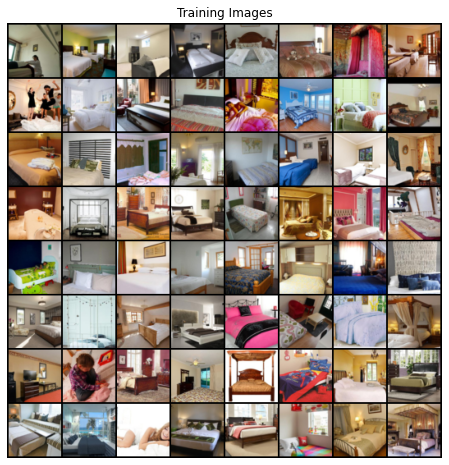

In [47]:
dataset = vdatasets.ImageFolder(root='./LSUN/data0/lsun/bedroom',
                                transform=T.Compose([
                                    T.Resize(image_size),
                                    T.CenterCrop(image_size),
                                    T.ToTensor(),
                                    T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                ]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

one_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title('Training Images')
plt.imshow(np.transpose(vutils.make_grid(one_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [48]:
# step_size = len(dataloader)

# optimizerD = torch.optim.SGD(netD.parameters(), lr=1e-5, momentum=0.5)
# optimizerG = torch.optim.SGD(netG.parameters(), lr=1e-5, momentum=0.9)
# schedulerD = torch.optim.lr_scheduler.CyclicLR(optimizerD, base_lr=1e-5, max_lr=0.0005,
#                                                step_size_up=step_size, gamma=0.75, mode='triangular2')
# schedulerG = torch.optim.lr_scheduler.CyclicLR(optimizerG, base_lr=1e-5, max_lr=0.0005,
#                                                step_size_up=step_size, gamma=0.75, mode='triangular2')

# optimizerD = optim.RMSprop(netD.parameters(), lr = 1e-4)
# optimizerG = optim.RMSprop(netG.parameters(), lr = 1e-4)

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, beta2))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, beta2))

# Train Loop for LSUN

In [49]:
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []

total_steps = num_epochs * len(dataloader)
fig_save_interval = total_steps // 30   # animation can contain max 36 images

pbar = tqdm_nb()
piter = 0

checkpoint = SaveCheckpoint()

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    pbar.reset(total=len(dataloader))
    for i, data in enumerate(dataloader, 0):
        pbar.update()
        piter += 1
        ################################################################
        # (1) Update D network: maximize D(x) + D(G(z)) 5 times
        ################################################################
        ## Train with all-real batch
        netD.zero_grad()
        
        real_img = data[0].to(device)
        b_size = real_img.size(0)
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake_img = netG(noise)
        
        errD = -torch.mean(netD(real_img)) + torch.mean(netD(fake_img)) # Wasserstein
        errD.backward(retain_graph=True)
        optimizerD.step()
        
        real_validity = netD(real_img)
        fake_validity = netD(fake_img)
        
        # calculate gradient penalty
        gp = gradient_penalty(netD, real_img, fake_img)
        
        # adversarial loss
        errD = -torch.mean(real_validity) + torch.mean(fake_validity) + lambda_gp * gp
        errD.backward()
        optimizerD.step()
        
        # Train Generator for every 5 steps
        if i % n_critics == 0:
            ################################################################
            # (2) Update G network: maximize D(G(z)
            ################################################################
            netG.zero_grad()

            gen_img = netG(noise)
            errG = -torch.mean(netD(gen_img))
            errG.backward(retain_graph=True)
            optimizerG.step()

            # Output training stats
            desc = '[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f' \
                    % (epoch+1, num_epochs, i, epoch_steps, errD.item(), errG.item())
            pbar.set_description(desc)

            # Save Losses for plotting later
            G_losses.append(errG.item())
            D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (piter - 1) % fig_save_interval == 0:
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append((epoch+1, i, vutils.make_grid(fake, padding=2, normalize=True)))
            print(desc)
    
#         # Update learning rates
#         schedulerG.step()
#         schedulerD.step()

pbar.refresh()

checkpoint.save([netG, netD], ['LSUN_netG', 'LSUN_netD'])

0it [00:00, ?it/s]

Starting Training Loop...
[1/10][0/1583] Loss_D: 31.9074 Loss_G: 3.1069
[1/10][1575/1583] Loss_D: -1682.7212 Loss_G: 871.5974
[1/10][3155/1583] Loss_D: -134.0229 Loss_G: -720.4327
[2/10][0/1583] Loss_D: -5194.7227 Loss_G: 2586.6675
[2/10][1575/1583] Loss_D: -7299.1245 Loss_G: 3638.7913
[2/10][3155/1583] Loss_D: -12481.9033 Loss_G: 6537.8867
[3/10][0/1583] Loss_D: 1028.8313 Loss_G: 7356.1060
[3/10][1575/1583] Loss_D: -21474.6523 Loss_G: 10829.0098
[3/10][3155/1583] Loss_D: -27925.9941 Loss_G: 13974.1719
[4/10][0/1583] Loss_D: -32476.8457 Loss_G: 16343.7129
[4/10][1575/1583] Loss_D: -39761.1484 Loss_G: 19986.3203
[4/10][3155/1583] Loss_D: -43813.9492 Loss_G: 22177.1484
[5/10][0/1583] Loss_D: 266.4934 Loss_G: 23033.6602
[5/10][1575/1583] Loss_D: -48642.7109 Loss_G: 25061.3672
[5/10][3155/1583] Loss_D: -53696.3477 Loss_G: 27333.6406
[6/10][0/1583] Loss_D: -65400.8438 Loss_G: 33087.9297
[6/10][1575/1583] Loss_D: -71492.1484 Loss_G: 36325.5781
[6/10][3155/1583] Loss_D: 256.1497 Loss_G: 37857

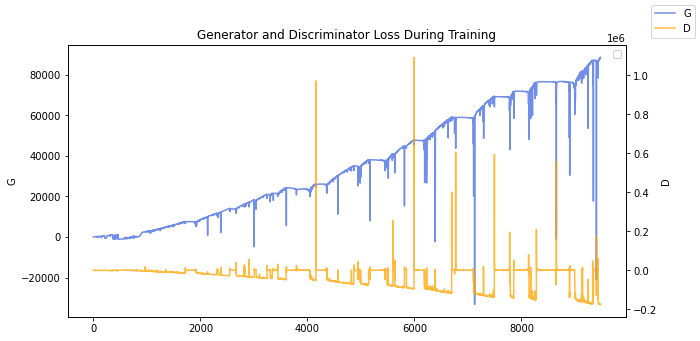

In [50]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
df = pd.DataFrame({'G': G_losses, 'D': D_losses})
ax1 = sns.lineplot(data=df, x=df.index, y='G', label='G', color='royalblue', alpha=.75)
ax2 = ax1.twinx()
sns.lineplot(data=df, x=df.index, y='D', label='D', color='orange', alpha=.75, ax=ax2)
for ax in [ax1, ax2]:
#     ax.set_ylim(bottom=0.)
    ax.legend([])
ax1.figure.legend()
plt.show()

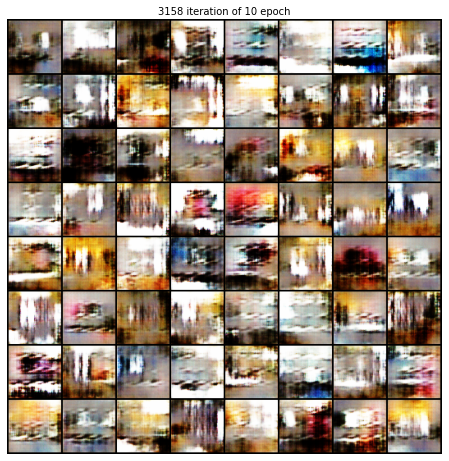

In [51]:
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111)
plt.axis('off')
imgs = [[
    plt.imshow(np.transpose(img, (1,2,0)), animated=True),
    plt.text(0.5, 1.01, f'{step} iteration of {epoch} epoch', horizontalalignment='center', transform=ax.transAxes),
] for epoch, step, img in img_list]

ani = animation.ArtistAnimation(fig, imgs, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

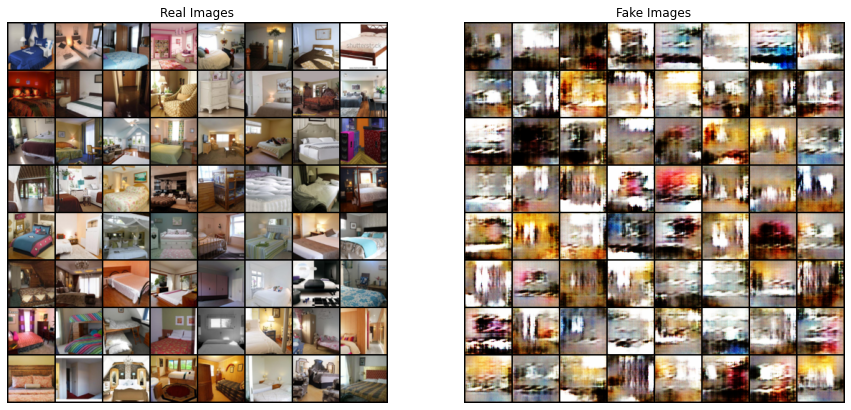

In [52]:
real_batch = next(iter(dataloader))

plt.figure(figsize=(15, 15))

plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1][-1],(1,2,0)))
plt.show()